In [1]:
%load_ext autoreload
%autoreload 2

%cd ..

/home/rainorangelemon/Documents/Attend-and-Excite


/home/rainorangelemon/micromamba/envs/sam2/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [5]:
from analyze_logp import load_and_prepare_data, get_two_objects
import numpy as np
import torch
prompt = "a turtle with a bow"
df, is_object_1, is_object_2, all_lift_results, all_final_latents, all_intermediate_latents = load_and_prepare_data(prompt)
score_results_same_noise = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=True.pt", weights_only=True), dim=0)
score_results_diff_noise = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=False.pt", weights_only=True), dim=0)
object_1, object_2 = get_two_objects(prompt)

10it [00:00, 10.05it/s]


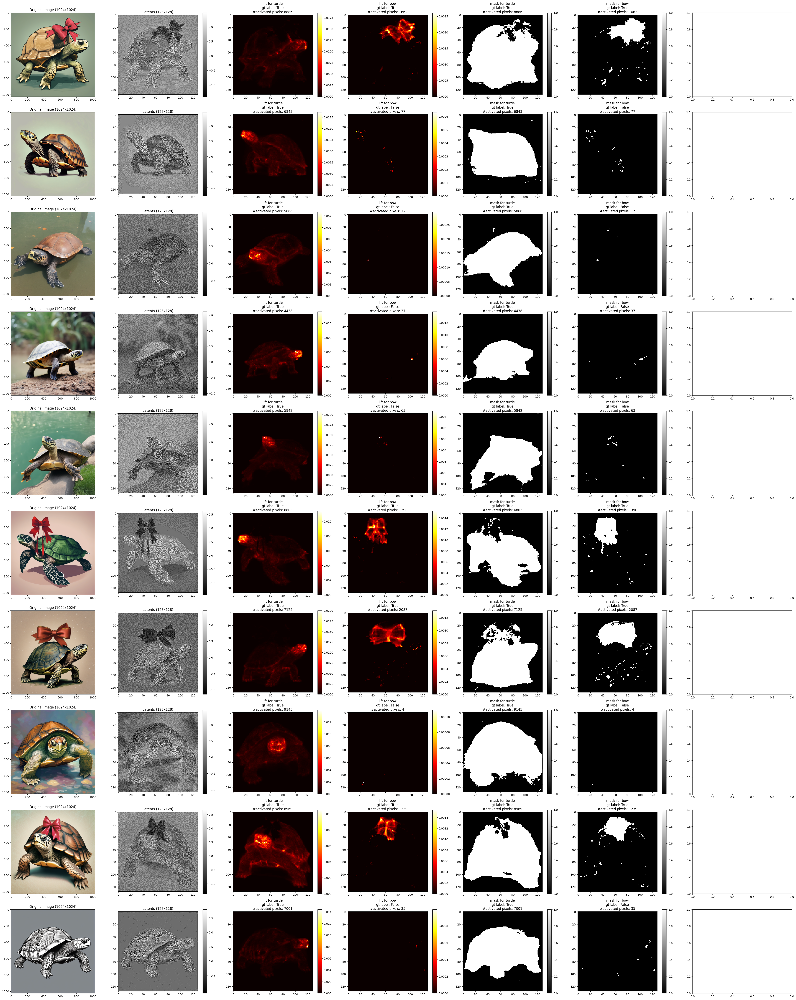

In [8]:
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm

device = "cpu"
threshold = 1e-4

same_noise = False
if same_noise:
    score_results = score_results_same_noise
else:
    score_results = score_results_diff_noise
latest_latents = all_final_latents

score_object_1_and_object_2_all = score_results[:, 0].to(device)
score_object_1_all = score_results[:, 1].to(device)
score_object_2_all = score_results[:, 2].to(device)
score_uncond_all = score_results[:, 3].to(device)
score_background_all = score_results[:, 4].to(device)

lift_object_1_and_object_2 = (score_object_1_and_object_2_all - score_object_1_all).pow(2)
lift_object_1 = (score_object_1_and_object_2_all - score_object_1_all).pow(2)
lift_object_2 = (score_object_1_and_object_2_all - score_object_2_all).pow(2)
lift_uncond = (score_object_1_and_object_2_all - score_uncond_all).pow(2)
lift_background = (score_object_1_and_object_2_all - score_background_all).pow(2)

plt.clf()
plt.close("all")
_, ax = plt.subplots(10, 7, figsize=(40, 50))
for ax_idx, img_idx in tqdm(enumerate(range(10))):
    # read the image
    image = Image.open(f"outputs/weak_lift/{prompt}/{img_idx}.png")
    ax[ax_idx][0].imshow(image)
    ax[ax_idx][0].set_title("Original Image (1024x1024)")

    latents = latest_latents[img_idx].mean(dim=0)
    # plot the heatmap
    im2 = ax[ax_idx][1].imshow(latents.cpu().numpy(), cmap="gray")
    plt.colorbar(im2, ax=ax[ax_idx][1])
    ax[ax_idx][1].set_title("Latents (128x128)")

    # heatmap = (score_black_car_and_white_clock_all - score_black_car_all).pow(2).mean(dim=1)[idx][-1]
    # heatmap_rectified = heatmap.clone()
    # heatmap_rectified[heatmap_rectified < 0] = 0
    # # plot the heatmap
    # im3 = ax[2].imshow(heatmap_rectified.cpu().numpy(), cmap="hot")
    # plt.colorbar(im3, ax=ax[2])
    # ax[2].set_title(f"white clock: {is_white_clock.values[idx]}, heatmap mean: {heatmap.mean().item():.2e}")

    heatmap = (lift_uncond[img_idx] - lift_object_1[img_idx]).mean(dim=(0, 1))
    # plot the heatmap if there exist activated pixels, otherwise plot a black image
    if (heatmap > threshold).sum().item() > 0:
        im4 = ax[ax_idx][2].imshow((heatmap - threshold).relu().cpu().numpy(), cmap="hot")
    else:
        im4 = ax[ax_idx][2].imshow(np.zeros((128, 128)), cmap="hot", vmin=0, vmax=1)
    plt.colorbar(im4, ax=ax[ax_idx][2])
    ax[ax_idx][2].set_title(f"lift for {object_1}\ngt label: {is_object_1.values[img_idx]}\n#activated pixels: {(heatmap > threshold).sum().item()}")

    heatmap = (lift_uncond[img_idx] - lift_object_2[img_idx]).mean(dim=(0, 1))
    # plot the heatmap
    if (heatmap > threshold).sum().item() > 0:
        im5 = ax[ax_idx][3].imshow((heatmap - threshold).relu().cpu().numpy(), cmap="hot")
    else:
        im5 = ax[ax_idx][3].imshow(np.zeros((128, 128)), cmap="hot", vmin=0, vmax=1)
    plt.colorbar(im5, ax=ax[ax_idx][3])
    ax[ax_idx][3].set_title(f"lift for {object_2}\ngt label: {is_object_2.values[img_idx]}\n#activated pixels: {(heatmap > threshold).sum().item()}")

    heatmap = (lift_uncond[img_idx] - lift_object_1[img_idx]).reshape(-1, 1, 4, 128, 128).mean(dim=(0, 2))
    heatmap = (heatmap > threshold).all(dim=0).float()
    # plot the heatmap
    im6 = ax[ax_idx][4].imshow(heatmap.cpu().numpy(), cmap="gray", vmin=0, vmax=1)
    plt.colorbar(im6, ax=ax[ax_idx][4])
    ax[ax_idx][4].set_title(f"mask for {object_1}\ngt label: {is_object_1.values[img_idx]}\n#activated pixels: {(heatmap > 0).sum().item()}")

    heatmap = (lift_uncond[img_idx] - lift_object_2[img_idx]).reshape(-1, 1, 4, 128, 128).mean(dim=(0, 2))
    heatmap = (heatmap > threshold).all(dim=0).float()
    # plot the heatmap
    im7 = ax[ax_idx][5].imshow(heatmap.cpu().numpy(), cmap="gray", vmin=0, vmax=1)
    plt.colorbar(im7, ax=ax[ax_idx][5])
    ax[ax_idx][5].set_title(f"mask for {object_2}\ngt label: {is_object_2.values[img_idx]}\n#activated pixels: {(heatmap > 0).sum().item()}")

    # # background
    # heatmap = ((lift_background < lift_object_1) & (lift_background < lift_object_2))[img_idx]
    # im8 = ax[ax_idx][6].imshow(heatmap.cpu().numpy(), cmap="gray", vmin=0, vmax=1)
    # plt.colorbar(im8, ax=ax[ax_idx][6])
    # ax[ax_idx][6].set_title(f"mask for background\n#activated pixels: {(heatmap > 0).sum().item()}")

plt.tight_layout()
# plt.savefig("a black car and a white clock.png")

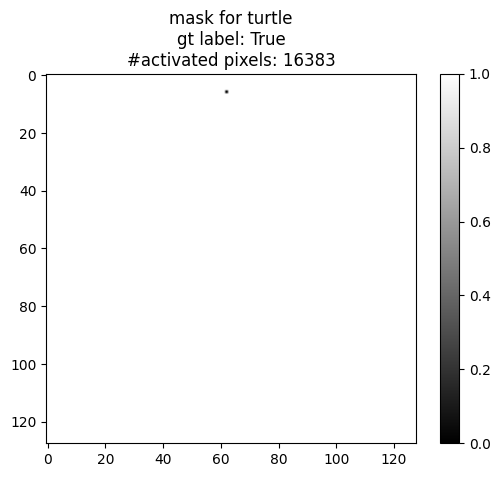

In [6]:
img_idx = 4
plt.clf()
plt.close("all")
_, ax = plt.subplots(1, 1)

# bootstrapping
bootstrap_num = 200
bootstrap_size = 200
bootstrap_idx = torch.randint(low=0, high=200, size=(bootstrap_num, bootstrap_size))

heatmap = (lift_object_1[img_idx] - lift_object_2[img_idx]).mean(dim=(0, 1))
heatmap = (heatmap < 0).float()
# plot the heatmap
im6 = ax.imshow(heatmap.cpu().numpy(), cmap="gray", vmin=0, vmax=1)
plt.colorbar(im6, ax=ax)
ax.set_title(f"mask for {object_1}\ngt label: {is_object_1.values[img_idx]}\n#activated pixels: {(heatmap > 0).sum().item()}")
plt.show()


In [89]:
# bootstrapping
bootstrap_num = 200
bootstrap_size = 200
bootstrap_idx = torch.randint(low=0, high=200, size=(bootstrap_num, bootstrap_size))
bootstrap_heatmaps = (lift_object_1[img_idx] - lift_object_2[img_idx])[bootstrap_idx].mean(dim=(1, 2))
intervals = bootstrap_heatmaps.quantile(q=[0.05, 0.95], dim=0)

torch.Size([200, 128, 128])

In [ ]:
img_idx = 4
plt.clf()
plt.close("all")
_, ax = plt.subplots(1, 1, figsize=(128, 128))

# bootstrapping
bootstrap_num = 200
bootstrap_size = 200
bootstrap_idx = torch.randint(low=0, high=200, size=(bootstrap_num, bootstrap_size))

bootstrap_heatmaps = (lift_object_1[img_idx] - lift_object_2[img_idx])[bootstrap_idx].mean(dim=(1, 2))
heatmap_max, heatmap_min = bootstrap_heatmaps.float().max(dim=0).values, bootstrap_heatmaps.float().min(dim=0).values
heatmap_mean = (lift_object_1[img_idx] - lift_object_2[img_idx]).mean(dim=(0, 1))
heatmap_upper = heatmap_mean + 4 * (heatmap_max - heatmap_mean)
heatmap_lower = heatmap_mean - 4 * (heatmap_mean - heatmap_min)

heatmap = ((heatmap_lower < 0) & (heatmap_upper < 0)).float()
# # plot the heatmap
# im6 = ax.imshow(heatmap.cpu().numpy(), cmap="gray", vmin=0, vmax=1)
# plt.colorbar(im6, ax=ax)
# plot the interval length
interval_length = heatmap_upper - heatmap_lower
im7 = ax.imshow(interval_length.cpu().numpy(), cmap="hot")
# show the values on each pixel
for i in range(128):
    for j in range(128):
        ax.text(j, i, f"{interval_length[i, j]:.2e}", ha="center", va="center", color="white")
plt.colorbar(im7, ax=ax)
ax.set_title(f"interval length for {object_1}\ngt label: {is_object_1.values[img_idx]}\n#activated pixels: {(heatmap > 0).sum().item()}")
# plt.show()
plt.savefig(f"turtle_interval.pdf")


In [3]:
from sklearn.metrics import roc_auc_score, roc_curve
from collections import defaultdict
import gc

gc.collect()

for prompt in ["a black car and a white clock", "a turtle with a bow", "a frog and a mouse"]:
    df, is_object_1, is_object_2, all_lift_results, all_final_latents, all_intermediate_latents = load_and_prepare_data(prompt)
    score_results_same_noise = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=True.pt", weights_only=True), dim=0)
    score_results_diff_noise = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=False.pt", weights_only=True), dim=0)
    object_1, object_2 = get_two_objects(prompt)

    best_auc_score_for_object_1 = 0
    best_auc_score_for_object_2 = 0
    # (same_noise, threshold, optimal_num_pixel_threshold)
    best_setting_for_object_1 = None
    best_setting_for_object_2 = None
    thresholds = [0, 5e-5, 1e-4, 5e-4, 8e-4, 1e-3, 5e-3, 8e-3, 1e-2]

    auc_scores = defaultdict(list)

    for same_noise in [True, False]:
        print(f"same noise: {same_noise}")
        if same_noise:
            score_results = score_results_same_noise
        else:
            score_results = score_results_diff_noise

        lift_o_object_1 = (score_results[:, 0] - score_results[:, 1]).pow(2).mean(dim=(1, 2))
        lift_o_object_2 = (score_results[:, 0] - score_results[:, 2]).pow(2).mean(dim=(1, 2))

        for threshold in thresholds:
            # lift_score_object_1 = (lift_o_object_1 < (lift_o_object_2 - threshold)).sum(dim=(1, 2)).cpu().numpy()
            # lift_score_object_2 = (lift_o_object_2 < (lift_o_object_1 - threshold)).sum(dim=(1, 2)).cpu().numpy()
            lift_score_object_1 = (lift_o_object_2 - lift_o_object_1).view(-1, 128 * 128).max(dim=1).values
            lift_score_object_2 = (lift_o_object_1 - lift_o_object_2).view(-1, 128 * 128).max(dim=1).values

            print(f"threshold: {threshold}")
            if is_object_1.std() != 0:
                auc_score_for_object_1 = roc_auc_score(is_object_1.values, lift_score_object_1)
                fpr_for_object_1, tpr_for_object_1, num_pixel_thresholds = roc_curve(is_object_1.values, lift_score_object_1)
                optimal_num_pixel_threshold_for_object_1 = num_pixel_thresholds[np.argmax(tpr_for_object_1 - fpr_for_object_1)]
            else:
                auc_score_for_object_1 = 1
                optimal_num_pixel_threshold_for_object_1 = None
            if is_object_2.std() != 0:
                auc_score_for_object_2 = roc_auc_score(is_object_2.values, lift_score_object_2)
                fpr_for_object_2, tpr_for_object_2, num_pixel_thresholds = roc_curve(is_object_2.values, lift_score_object_2)
                optimal_num_pixel_threshold_for_object_2 = num_pixel_thresholds[np.argmax(tpr_for_object_2 - fpr_for_object_2)]
            else:
                auc_score_for_object_2 = 1
                optimal_num_pixel_threshold_for_object_2 = None
            print(f"AUC score for {object_1}: {auc_score_for_object_1:.4f}, #activated pixels: {lift_score_object_1.mean().item():.1f}")
            print(f"AUC score for {object_2}: {auc_score_for_object_2:.4f}, #activated pixels: {lift_score_object_2.mean().item():.1f}")
            print(f"optimal #activated pixels for {object_1}: {optimal_num_pixel_threshold_for_object_1}")
            print(f"optimal #activated pixels for {object_2}: {optimal_num_pixel_threshold_for_object_2}")
            auc_scores["object_1", same_noise].append(auc_score_for_object_1)
            auc_scores["object_2", same_noise].append(auc_score_for_object_2)


            if auc_score_for_object_1 > best_auc_score_for_object_1:
                best_auc_score_for_object_1 = auc_score_for_object_1
                best_setting_for_object_1 = (same_noise, threshold, optimal_num_pixel_threshold_for_object_1)
            if auc_score_for_object_2 > best_auc_score_for_object_2:
                best_auc_score_for_object_2 = auc_score_for_object_2
                best_setting_for_object_2 = (same_noise, threshold, optimal_num_pixel_threshold_for_object_2)

    plt.clf()
    plt.close("all")
    # plot in one figure
    plt.plot(thresholds, auc_scores["object_1", True], label=f"{object_1} (same noise)")
    plt.plot(thresholds, auc_scores["object_1", False], label=f"{object_1} (diff noise)")
    plt.plot(thresholds, auc_scores["object_2", True], label=f"{object_2} (same noise)")
    plt.plot(thresholds, auc_scores["object_2", False], label=f"{object_2} (diff noise)")
    plt.legend()
    plt.tight_layout()
    plt.show()

    print(f"best setting for {object_1}: {best_setting_for_object_1}")
    print(f"best setting for {object_2}: {best_setting_for_object_2}")


KeyboardInterrupt: 

In [9]:
for prompt in ["a black car and a white clock", "a turtle with a bow", "a frog and a mouse"]:
    result = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=False.pt", weights_only=True), dim=0)
    print(result.shape)
    del result

torch.Size([100, 5, 200, 4, 128, 128])
torch.Size([100, 5, 200, 4, 128, 128])
torch.Size([100, 5, 200, 4, 128, 128])


same noise: True
threshold: 0
AUC score for black car: 0.7342
AUC score for white clock: 0.7691
optimal #activated pixels for black car: 13974.0
optimal #activated pixels for white clock: 5672.0
threshold: 5e-05
AUC score for black car: 0.5922
AUC score for white clock: 0.8213
optimal #activated pixels for black car: 2019.0
optimal #activated pixels for white clock: 1217.0
threshold: 0.0001
AUC score for black car: 0.6013
AUC score for white clock: 0.8693
optimal #activated pixels for black car: 756.0
optimal #activated pixels for white clock: 481.0
threshold: 0.0002
AUC score for black car: 0.5764
AUC score for white clock: 0.9003
optimal #activated pixels for black car: 225.0
optimal #activated pixels for white clock: 278.0
threshold: 0.0005
AUC score for black car: 0.4655
AUC score for white clock: 0.9257
optimal #activated pixels for black car: 35.0
optimal #activated pixels for white clock: 73.0
threshold: 0.001
AUC score for black car: 0.4485
AUC score for white clock: 0.8986
opt

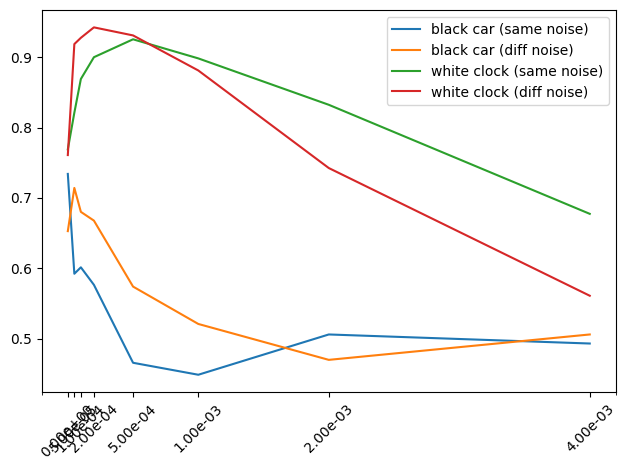

best setting for black car: (True, 0, np.float64(13974.0))
best setting for white clock: (False, 0.0002, np.float64(244.0))
same noise: True
threshold: 0
AUC score for turtle: 1.0000
AUC score for bow: 0.8051
optimal #activated pixels for turtle: None
optimal #activated pixels for bow: 5877.0
threshold: 5e-05
AUC score for turtle: 1.0000
AUC score for bow: 0.9774
optimal #activated pixels for turtle: None
optimal #activated pixels for bow: 1422.0
threshold: 0.0001
AUC score for turtle: 1.0000
AUC score for bow: 0.9919
optimal #activated pixels for turtle: None
optimal #activated pixels for bow: 876.0
threshold: 0.0002
AUC score for turtle: 1.0000
AUC score for bow: 0.9964
optimal #activated pixels for turtle: None
optimal #activated pixels for bow: 370.0
threshold: 0.0005
AUC score for turtle: 1.0000
AUC score for bow: 0.9887
optimal #activated pixels for turtle: None
optimal #activated pixels for bow: 155.0
threshold: 0.001
AUC score for turtle: 1.0000
AUC score for bow: 0.9315
optima

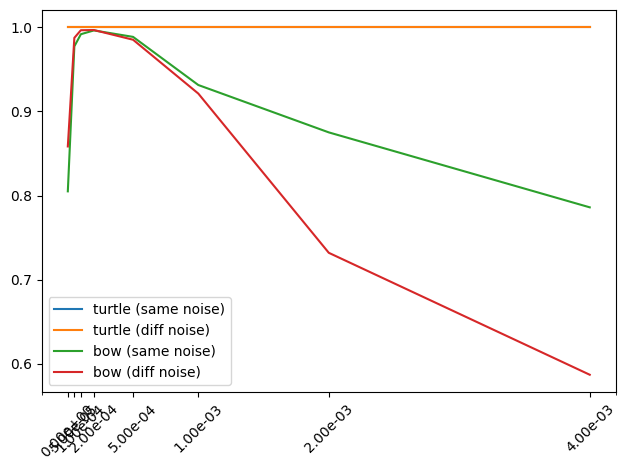

best setting for turtle: (True, 0, None)
best setting for bow: (False, 0.0002, np.float64(155.0))
same noise: True
threshold: 0
AUC score for frog: 1.0000
AUC score for mouse: 0.4702
optimal #activated pixels for frog: None
optimal #activated pixels for mouse: 7233.0
threshold: 5e-05
AUC score for frog: 1.0000
AUC score for mouse: 0.6762
optimal #activated pixels for frog: None
optimal #activated pixels for mouse: 1159.0
threshold: 0.0001
AUC score for frog: 1.0000
AUC score for mouse: 0.6904
optimal #activated pixels for frog: None
optimal #activated pixels for mouse: 585.0
threshold: 0.0002
AUC score for frog: 1.0000
AUC score for mouse: 0.7239
optimal #activated pixels for frog: None
optimal #activated pixels for mouse: 429.0
threshold: 0.0005
AUC score for frog: 1.0000
AUC score for mouse: 0.7923
optimal #activated pixels for frog: None
optimal #activated pixels for mouse: 231.0
threshold: 0.001
AUC score for frog: 1.0000
AUC score for mouse: 0.8120
optimal #activated pixels for fr

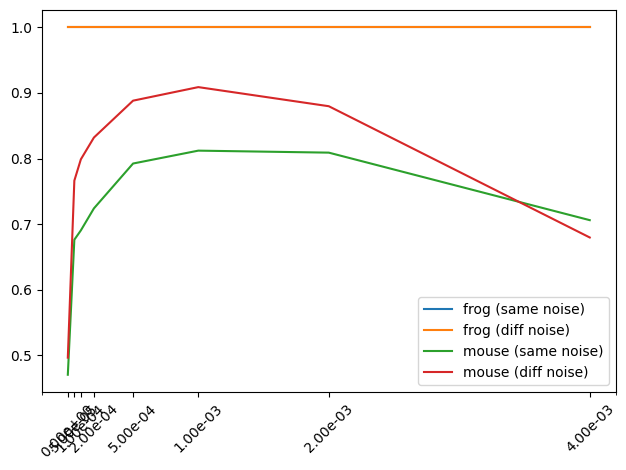

best setting for frog: (True, 0, None)
best setting for mouse: (False, 0.001, np.float64(56.0))


In [15]:
from sklearn.metrics import roc_auc_score, roc_curve
from collections import defaultdict
import gc

gc.collect()

for prompt in ["a black car and a white clock", "a turtle with a bow", "a frog and a mouse"]:
    df, is_object_1, is_object_2, all_lift_results, all_final_latents, all_intermediate_latents = load_and_prepare_data(prompt)
    score_results_same_noise = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=True.pt", weights_only=True), dim=0)
    score_results_diff_noise = torch.cat(torch.load(f"outputs/weak_lift/score_results_{prompt}_same_noise=False.pt", weights_only=True), dim=0)
    object_1, object_2 = get_two_objects(prompt)

    best_auc_score_for_object_1 = 0
    best_auc_score_for_object_2 = 0
    # (same_noise, threshold, optimal_num_pixel_threshold)
    best_setting_for_object_1 = None
    best_setting_for_object_2 = None
    thresholds = [0, 5e-5, 1e-4, 2e-4, 5e-4, 1e-3, 2e-3, 4e-3]

    auc_scores = defaultdict(list)

    for same_noise in [True, False]:
        print(f"same noise: {same_noise}")
        if same_noise:
            score_results = score_results_same_noise
        else:
            score_results = score_results_diff_noise

        lift_o_object_1 = (score_results[:, 0] - score_results[:, 1]).pow(2).mean(dim=(1, 2))
        lift_o_object_2 = (score_results[:, 0] - score_results[:, 2]).pow(2).mean(dim=(1, 2))
        lift_o_uncond = (score_results[:, 0] - score_results[:, 3]).pow(2).mean(dim=(1, 2))

        for threshold in thresholds:
            lift_score_object_1 = (lift_o_object_1 < (lift_o_uncond - threshold)).sum(dim=(1, 2)).cpu().numpy()
            lift_score_object_2 = (lift_o_object_2 < (lift_o_uncond - threshold)).sum(dim=(1, 2)).cpu().numpy()
            # lift_score_object_1 = (lift_o_uncond - lift_o_object_1).view(-1, 128 * 128).max(dim=1).values > threshold
            # lift_score_object_2 = (lift_o_uncond - lift_o_object_2).view(-1, 128 * 128).max(dim=1).values > threshold

            print(f"threshold: {threshold}")
            if is_object_1.std() != 0:
                auc_score_for_object_1 = roc_auc_score(is_object_1.values, lift_score_object_1)
                fpr_for_object_1, tpr_for_object_1, num_pixel_thresholds = roc_curve(is_object_1.values, lift_score_object_1)
                optimal_num_pixel_threshold_for_object_1 = num_pixel_thresholds[np.argmax(tpr_for_object_1 - fpr_for_object_1)]
            else:
                auc_score_for_object_1 = 1
                optimal_num_pixel_threshold_for_object_1 = None
            if is_object_2.std() != 0:
                auc_score_for_object_2 = roc_auc_score(is_object_2.values, lift_score_object_2)
                fpr_for_object_2, tpr_for_object_2, num_pixel_thresholds = roc_curve(is_object_2.values, lift_score_object_2)
                optimal_num_pixel_threshold_for_object_2 = num_pixel_thresholds[np.argmax(tpr_for_object_2 - fpr_for_object_2)]
            else:
                auc_score_for_object_2 = 1
                optimal_num_pixel_threshold_for_object_2 = None
            print(f"AUC score for {object_1}: {auc_score_for_object_1:.4f}")
            print(f"AUC score for {object_2}: {auc_score_for_object_2:.4f}")
            print(f"optimal #activated pixels for {object_1}: {optimal_num_pixel_threshold_for_object_1}")
            print(f"optimal #activated pixels for {object_2}: {optimal_num_pixel_threshold_for_object_2}")
            auc_scores["object_1", same_noise].append(auc_score_for_object_1)
            auc_scores["object_2", same_noise].append(auc_score_for_object_2)


            if auc_score_for_object_1 > best_auc_score_for_object_1:
                best_auc_score_for_object_1 = auc_score_for_object_1
                best_setting_for_object_1 = (same_noise, threshold, optimal_num_pixel_threshold_for_object_1)
            if auc_score_for_object_2 > best_auc_score_for_object_2:
                best_auc_score_for_object_2 = auc_score_for_object_2
                best_setting_for_object_2 = (same_noise, threshold, optimal_num_pixel_threshold_for_object_2)

    plt.clf()
    plt.close("all")
    # plot in one figure
    plt.plot(thresholds, auc_scores["object_1", True], label=f"{object_1} (same noise)")
    plt.plot(thresholds, auc_scores["object_1", False], label=f"{object_1} (diff noise)")
    plt.plot(thresholds, auc_scores["object_2", True], label=f"{object_2} (same noise)")
    plt.plot(thresholds, auc_scores["object_2", False], label=f"{object_2} (diff noise)")
    plt.legend()
    plt.xscale("symlog")
    # label in .2e format
    plt.xticks(thresholds, [f"{t:.2e}" for t in thresholds])
    # 45 degree rotation
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    print(f"best setting for {object_1}: {best_setting_for_object_1}")
    print(f"best setting for {object_2}: {best_setting_for_object_2}")

# Quick Test: Whether the Latent is Matched

In [5]:
!ls

%cd ..

analyze_logp.ipynb	   explain.ipynb	  tune_hyperparam.ipynb
create_lift_folders.ipynb  generate_images.ipynb
/home/rainorangelemon/Documents/Attend-and-Excite


/home/rainorangelemon/micromamba/envs/sam2/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


/tmp/ipykernel_1023418/723435372.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  final_latents1 = torch.load("outputs/weak_lift/a turtle with a bow/0_lift_results.pt")["

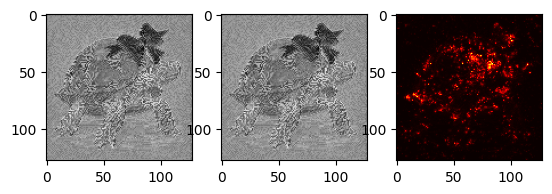

In [7]:
import torch
import matplotlib.pyplot as plt

# load the turtle with a bow from the score results
final_latents1 = torch.load("outputs/weak_lift/a turtle with a bow/0_lift_results.pt")["latents"]
# load the turtle with a bow from the outputs/standard_sd_xl_lift
final_latents2 = torch.load("outputs/standard_sd_xl_lift/a turtle with a bow/0_lift_results.pt")["latents"]
# whether the score and the latent are matched
torch.allclose(final_latents1, final_latents2)

plt.clf()
plt.close("all")
# plot latents side by side
_, ax = plt.subplots(1, 3)
ax[0].imshow(final_latents1.mean(dim=(0, 1)).cpu().numpy(), cmap="gray")
ax[1].imshow(final_latents2.mean(dim=(0, 1)).cpu().numpy(), cmap="gray")
ax[2].imshow((final_latents1 - final_latents2).abs()[0].max(dim=0).values.cpu().numpy(), cmap="hot")
plt.show()

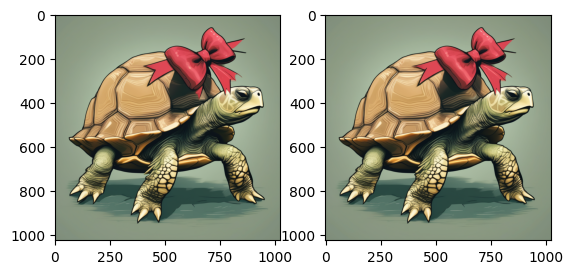

In [8]:
from PIL import Image
# show images
img1 = Image.open("outputs/weak_lift/a turtle with a bow/0.png")
img2 = Image.open("outputs/standard_sd_xl_lift/a turtle with a bow/0.png")
_, ax = plt.subplots(1, 2)
ax[0].imshow(img1)
ax[1].imshow(img2)
plt.show()

# Check the logp_analyze result from standard_sd_xl_lift

In [1]:
from pathlib import Path
import glob
import matplotlib.pyplot as plt
from PIL import Image

import torch
noise = torch.load("/home/rainorangelemon/Documents/Attend-and-Excite/noise_[4_128_128].pt")

threshold = 1e-4

prompt = "a rabbit and a mouse"
object_1, object_2 = get_two_objects(prompt)
folder_path = Path("outputs/standard_sd_xl_lift") / prompt
files = glob.glob(f"{str(folder_path)}/*_score_results.pt")
number_of_files = len(files)
for img_idx in range(number_of_files):
    score_result = torch.load(f"{str(folder_path)}/{img_idx}_score_results.pt", weights_only=True, map_location="cpu")
    score_object_1_and_object_2 = score_result[:, 0]
    score_object_1 = score_result[:, 1]
    score_object_2 = score_result[:, 2]
    # base = noise[:200]
    base = score_object_1_and_object_2
    lift_object_1 = (base - score_object_1).pow(2).mean(dim=(1, 2))[0]
    lift_object_2 = (base - score_object_2).pow(2).mean(dim=(1, 2))[0]
    lift_object_1_and_object_2 = (base - score_object_1_and_object_2).pow(2).mean(dim=(1, 2))[0]

    # plot the heatmap
    plt.clf()
    plt.close("all")
    _, ax = plt.subplots(1, 5, figsize=(30, 5))
    image = Image.open(f"{str(folder_path)}/{img_idx}.png")
    ax[0].imshow(image)
    im0 = ax[1].imshow((lift_object_2 - lift_object_1).relu().cpu().numpy(), cmap="hot")
    ax[1].set_title(f"lift for {object_1}, #activated pixels: {((lift_object_2 - lift_object_1).relu().cpu().numpy() > threshold).sum()}")
    plt.colorbar(im0, ax=ax[1])
    im1 = ax[2].imshow((lift_object_1 - lift_object_2).relu().cpu().numpy(), cmap="hot")
    ax[2].set_title(f"lift for {object_2}, #activated pixels: {((lift_object_1 - lift_object_2).relu().cpu().numpy() > threshold).sum()}")
    plt.colorbar(im1, ax=ax[2])
    # binary the heatmap
    heatmap_object_1 = (lift_object_2 - lift_object_1).relu().cpu().numpy() > threshold
    heatmap_object_2 = (lift_object_1 - lift_object_2).relu().cpu().numpy() > threshold
    ax[3].imshow(heatmap_object_1, cmap="gray", vmin=0, vmax=1)
    ax[4].imshow(heatmap_object_2, cmap="gray", vmin=0, vmax=1)
    plt.tight_layout()
    plt.show()


/tmp/ipykernel_1676749/229116737.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  noise = torch.load("/home/rainorangelemon/Documents/Attend-and-Excite/noise_[4_128_128].

NameError: name 'get_two_objects' is not defined

In [86]:
from tqdm import tqdm
# calculate how many pt files obey the constraint
files = glob.glob(f"outputs/standard_sd_xl_lift/*/*_score_results.pt", recursive=True)
threshold = 1e-3
count = 0
for file in tqdm(files):
    score_result = torch.load(file, weights_only=True, map_location="cuda:0")
    score_object_1_and_object_2 = score_result[:, 0]
    score_object_1 = score_result[:, 1]
    score_object_2 = score_result[:, 2]
    lift_object_1 = (score_object_1_and_object_2 - score_object_1).pow(2).mean(dim=(1, 2))[0]
    lift_object_2 = (score_object_1_and_object_2 - score_object_2).pow(2).mean(dim=(1, 2))[0]
    if ((lift_object_1 - lift_object_2).max() < threshold) or ((lift_object_2 - lift_object_1).max() < threshold):
        count += 1
count

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1380/1380 [01:01<00:00, 22.49it/s]


476

# Tune the global hyperparam

In [1]:
%cd ..
# run the metrics for original data
import os
import json
# original_folder = "outputs/weak_lift"
original_folder = "outputs/standard_sd_xl_lift"
# original_folder = "outputs/standard_sd_2_1_lift"
# original_folder = "outputs/standard_sd_1_4_lift"


/home/rainorangelemon/Documents/Attend-and-Excite


/home/rainorangelemon/micromamba/envs/sam2/lib/python3.10/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
if not os.path.exists(f"{original_folder}/clip_raw_metrics.json"):
    # run the clip metrics
    os.system(f"python metrics/compute_clip_similarity.py --output_path={original_folder} --metrics_save_path={original_folder} > /dev/null 2>&1")
    # load the metrics results
    with open(f"{original_folder}/clip_raw_metrics.json", "r") as f:
        metrics_results = json.load(f)
else:
    with open(f"{original_folder}/clip_raw_metrics.json", "r") as f:
        raw_metrics_results = json.load(f)


In [3]:
with open(f"{original_folder}/clip_raw_metrics.json", "r") as f:
    raw_metrics_results = json.load(f)

# create a df, each row is a sample, each column includes: prompt, image_name, clip_score
import pandas as pd
# Create a list of dictionaries for all rows
data = [
    {
        "prompt": prompt,
        "image_name": image_name,
        "clip_score": full_text_score,
        "first_half_text_score": first_half_text_score,
        "second_half_text_score": second_half_text_score
    }
    for prompt in raw_metrics_results.keys()
    for image_name, full_text_score, first_half_text_score, second_half_text_score in zip(
        raw_metrics_results[prompt]['image_names'],
        raw_metrics_results[prompt]['full_text'],
        raw_metrics_results[prompt]['first_half'],
        raw_metrics_results[prompt]['second_half']
    )
]

# Create DataFrame from the list of dictionaries
df = pd.DataFrame(data)

df

,prompt,image_name,clip_score,first_half_text_score,second_half_text_score
0,a black car and a white clock,33.png,0.271255,0.279624,0.184574
1,a black car and a white clock,89.png,0.345491,0.287808,0.264497
2,a black car and a white clock,92.png,0.300765,0.270511,0.222669
3,a black car and a white clock,67.png,0.364833,0.267302,0.297930
4,a black car and a white clock,74.png,0.297469,0.239417,0.247890
...,...,...,...,...,...
895,a turtle with a bow,heatmap_13_old.png,0.285084,0.282389,0.189398
896,a turtle with a bow,heatmap_61.png,0.262431,0.272044,0.182674
897,a turtle with a bow,heatmap_67.png,0.280626,0.282314,0.178210
898,a turtle with a bow,heatmap_49.png,0.277999,0.285611,0.178025


In [4]:
from tqdm import tqdm
import gc
from torchvision.transforms import GaussianBlur
import torch
from scipy import ndimage

def apply_median_filter(tensor, kernel_size=3):
    """
    Apply median filter to a PyTorch tensor

    Parameters:
    - tensor: Input PyTorch tensor
    - kernel_size: Size of the median filter kernel (default: 3)

    Returns:
    - Filtered tensor
    """
    # Store original device
    device = tensor.device

    # Convert to numpy array, ensuring it's float32
    if tensor.dim() == 2:
        numpy_array = tensor.detach().cpu().float().numpy()
    else:
        numpy_array = tensor.detach().cpu().float().squeeze().numpy()

    # Ensure the array is contiguous and in the correct format
    numpy_array = np.ascontiguousarray(numpy_array)

    # Apply median filter
    filtered = ndimage.median_filter(numpy_array, size=kernel_size)

    # Convert back to torch tensor
    return torch.from_numpy(filtered).float().to(device)


def plot_heatmaps(heatmap1, heatmap2, title1, title2):
    plt.clf()
    plt.close("all")
    _, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(heatmap1, cmap="hot")
    ax[1].imshow(heatmap2, cmap="hot")
    plt.show()


# load the score results
thresholds = [0, 9e-5, 1e-4, 2e-4, 3e-4, 4e-4, 5e-4, 6e-4, 7e-4, 8e-4, 9e-4, 1e-3]

for prompt in tqdm(df['prompt'].unique()):
    gc.collect()
    torch.cuda.empty_cache()
    num_of_samples = 5 if "weak_lift" not in original_folder else 100

    if "weak_lift" in original_folder:
        score_results_all = torch.load(f"{original_folder}/score_results_{prompt}_same_noise=False.pt", weights_only=True, map_location="cpu")

    for seed in range(num_of_samples):
        if "weak_lift" in original_folder:
            score_results = score_results_all[seed]
        else:
            score_results = torch.load(f"{original_folder}/{prompt}/{seed}_score_results.pt", weights_only=True, map_location="cpu")

        score_results = score_results.float()
        if score_results.shape[1] > 3:
            score_composed = score_results[:, 0]
            score_object_1 = score_results[:, 1]
            score_object_2 = score_results[:, 2]
            score_uncond = score_results[:, 3]

            lift_object_1 = ((score_uncond - score_composed).pow(2) - (score_object_1 - score_composed).pow(2)).mean(dim=(1, 2))
            lift_object_2 = ((score_uncond - score_composed).pow(2) - (score_object_2 - score_composed).pow(2)).mean(dim=(1, 2))
            lift_object_1_old = ((score_object_2 - score_composed).pow(2) - (score_object_1 - score_composed).pow(2)).mean(dim=(1, 2))
            lift_object_2_old = ((score_object_1 - score_composed).pow(2) - (score_object_2 - score_composed).pow(2)).mean(dim=(1, 2))

        else:
            assert False
            # lift_object_1 = torch.ones_like(score_results[:, 0]).mean(dim=(1, 2))
            # lift_object_2 = torch.ones_like(score_results[:, 0]).mean(dim=(1, 2))

        # lift_object_1 = GaussianBlur(kernel_size=3)(lift_object_1.float()[None])[0]
        # lift_object_2 = GaussianBlur(kernel_size=3)(lift_object_2.float()[None])[0]

        df.loc[(df['prompt'] == prompt) & (df['image_name'] == f"{seed}.png"), 'maximum_lift_object_1'] = lift_object_1.max()
        df.loc[(df['prompt'] == prompt) & (df['image_name'] == f"{seed}.png"), 'maximum_lift_object_2'] = lift_object_2.max()

        for threshold in thresholds:
            threshold_str = f"{threshold:.0e}"

            activated_pixels_for_object_1 = (lift_object_1 > threshold).sum()
            activated_pixels_for_object_2 = (lift_object_2 > threshold).sum()
            activated_pixels_for_object_1_old = (lift_object_1_old > threshold).sum()
            activated_pixels_for_object_2_old = (lift_object_2_old > threshold).sum()
            df.loc[(df['prompt'] == prompt) & (df['image_name'] == f"{seed}.png"), f'activated_pixels_for_object_1_{threshold_str}'] = activated_pixels_for_object_1
            df.loc[(df['prompt'] == prompt) & (df['image_name'] == f"{seed}.png"), f'activated_pixels_for_object_2_{threshold_str}'] = activated_pixels_for_object_2
            df.loc[(df['prompt'] == prompt) & (df['image_name'] == f"{seed}.png"), f'activated_pixels_for_object_1_old_{threshold_str}'] = activated_pixels_for_object_1_old
            df.loc[(df['prompt'] == prompt) & (df['image_name'] == f"{seed}.png"), f'activated_pixels_for_object_2_old_{threshold_str}'] = activated_pixels_for_object_2_old

# clip_scores = df['clip_score'].values
# df

100%|██████████| 276/276 [01:29<00:00,  3.09it/s]


In [5]:
# remove the samples with image_name "heatmap_x.png"
df = df[~df['image_name'].str.contains("heatmap")]
df.head()

,prompt,image_name,clip_score,first_half_text_score,second_half_text_score,maximum_lift_object_1,maximum_lift_object_2,activated_pixels_for_object_1_0e+00,activated_pixels_for_object_2_0e+00,activated_pixels_for_object_1_old_0e+00,...,activated_pixels_for_object_1_old_8e-04,activated_pixels_for_object_2_old_8e-04,activated_pixels_for_object_1_9e-04,activated_pixels_for_object_2_9e-04,activated_pixels_for_object_1_old_9e-04,activated_pixels_for_object_2_old_9e-04,activated_pixels_for_object_1_1e-03,activated_pixels_for_object_2_1e-03,activated_pixels_for_object_1_old_1e-03,activated_pixels_for_object_2_old_1e-03
0,a bear and a blue clock,0.png,0.364233,0.256911,0.293413,0.002181,0.006466,3186,2844,1954,...,171,367,90,283,141,310,68,254,120,280
1,a bear and a blue clock,3.png,0.372639,0.268120,0.309120,0.004711,0.005584,2885,3465,1707,...,68,236,47,195,55,211,36,170,43,192
2,a bear and a blue clock,1.png,0.370287,0.249275,0.294945,0.002528,0.008233,2303,3157,1324,...,146,302,81,255,101,295,61,236,78,284
3,a bear and a blue clock,2.png,0.370550,0.257737,0.304592,0.002164,0.007255,3698,1920,3368,...,120,317,40,232,74,277,31,200,59,240
4,a bear and a blue clock,4.png,0.375691,0.270845,0.300568,0.004778,0.00542,3216,3639,1513,...,227,761,201,687,184,669,170,609,160,613


In [6]:
import numpy as np
# read a.e_prompts.t
with open("a.e_prompts.txt", "r") as f:
    prompt_classes = json.load(f)

for threshold in thresholds:
    print("================================")
    print(threshold)
    threshold_str = f"{threshold:.0e}"
    for prompt_class in prompt_classes.keys():
        print(f"prompt class: {prompt_class}")
        pixel_thresholds = [1, 10, 25, 50, 100, 125, 150, 175, 200, 225, 250, 300, 500, 1200, 2000, 3000, 16384]
        for pixel_threshold in pixel_thresholds:
            # # print the mean of clip scores
            # print(f"mean of clip scores: {clip_scores.mean():.4f}")
            # # print the mean of filtered clip scores
            # print(f"mean of filtered clip scores: {clip_scores[df[['activated_pixels_for_object_1', 'activated_pixels_for_object_2']].min(axis=1) > pixel_threshold].mean():.4f}")
            n_wins = 0
            n_comparisons = 0
            n_reject = 0
            sum_filtered_clip_scores = []
            sum_all_clip_scores = []
            for prompt in prompt_classes[prompt_class]:
                sub_df = df[df['prompt'] == prompt]
                k = (sub_df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1) >= pixel_threshold).sum()
                n_reject += (len(sub_df) - k)
                if (k > 0) and (k < len(sub_df)):
                    # calculate the avg clip score for samples filtered out
                    avg_clip_score_for_filtered_samples = sub_df[sub_df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1) >= pixel_threshold]['clip_score'].mean()
                    # calculate the avg clip score for samples not filtered out
                    avg_clip_score_for_all_samples = sub_df['clip_score'].mean()
                    n_wins += (avg_clip_score_for_filtered_samples > avg_clip_score_for_all_samples)
                    n_comparisons += 1
                    sum_filtered_clip_scores.append(avg_clip_score_for_filtered_samples)
                    sum_all_clip_scores.append(avg_clip_score_for_all_samples)
                elif k == 0:
                    # choose the best one
                    best_pixel_threshold = sub_df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1).max()
                    sum_filtered_clip_scores.append(sub_df[sub_df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1) == best_pixel_threshold]['clip_score'].mean())
                    sum_all_clip_scores.append(sub_df['clip_score'].mean())
                else:
                    sum_filtered_clip_scores.append(sub_df['clip_score'].mean())
                    sum_all_clip_scores.append(sub_df['clip_score'].mean())

            if n_comparisons:
                print(pixel_threshold, np.mean(sum_filtered_clip_scores) / np.mean(sum_all_clip_scores),
                    np.mean(sum_filtered_clip_scores),
                    np.mean(sum_all_clip_scores),
                    n_reject / (len(sub_df) * len(prompt_classes[prompt_class])),
                    n_wins / n_comparisons, n_comparisons / len(prompt_classes[prompt_class]))

0
prompt class: animals
1 1.0000375356414402 0.3101108065834551 0.31009916681231875 0.0030303030303030303 1.0 0.015151515151515152
10 1.004866876619024 0.31160838119685647 0.31009916681231875 0.04242424242424243 1.0 0.10606060606060606
25 1.0069692243329422 0.3122603174712923 0.31009916681231875 0.06060606060606061 1.0 0.12121212121212122
50 1.0093323076233278 0.31299310763074895 0.31009916681231875 0.09393939393939393 0.8333333333333334 0.18181818181818182
100 1.010339214848463 0.31330534872232063 0.31009916681231875 0.1303030303030303 0.9285714285714286 0.21212121212121213
125 1.0095735610655825 0.3130679201221827 0.31009916681231875 0.14545454545454545 0.8235294117647058 0.25757575757575757
150 1.011173814529803 0.31356415738812604 0.31009916681231875 0.1606060606060606 0.8125 0.24242424242424243
175 1.0139274714199777 0.3144180640954562 0.31009916681231875 0.1696969696969697 0.8823529411764706 0.25757575757575757
200 1.0150249283220956 0.3147583845664154 0.31009916681231875 0.17878

In [6]:
# save df
df.to_csv(f'{original_folder}/metrics.csv', index=False)

In [2]:
# read df
import pandas as pd
df = pd.read_csv(f'{original_folder}/metrics.csv')
thresholds = [0, 9e-5, 1e-4, 2e-4, 3e-4, 4e-4, 5e-4, 6e-4, 7e-4, 8e-4, 9e-4, 1e-3]

prompt: a black car and a white clock
ratio of samples with activated pixels larger than 200 for a black car and a white clock: 0.0367
clip score for all samples: 0.2697
clip score for samples with activated pixels larger than 200: 0.3523


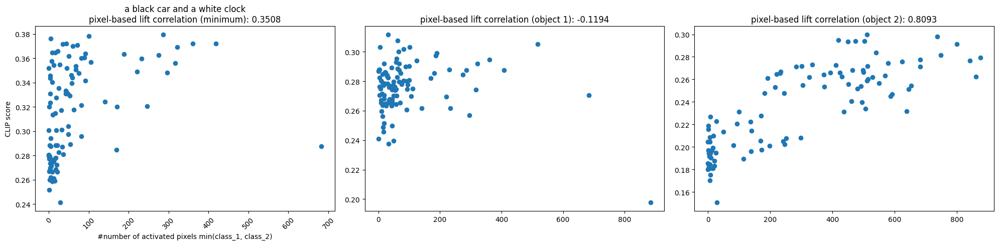

prompt: a frog and a mouse
ratio of samples with activated pixels larger than 200 for a frog and a mouse: 0.1067
clip score for all samples: 0.2692
clip score for samples with activated pixels larger than 200: 0.3293


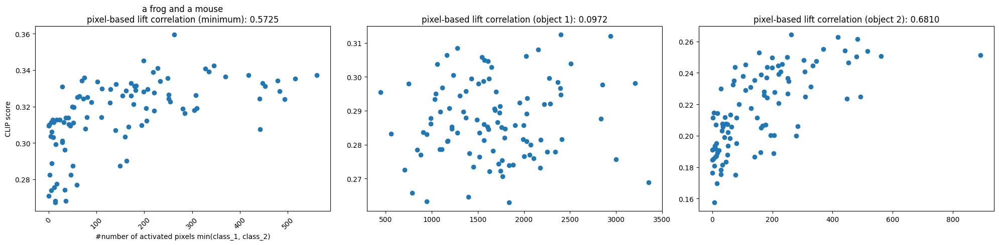

prompt: a turtle with a bow
ratio of samples with activated pixels larger than 200 for a turtle with a bow: 0.1033
clip score for all samples: 0.2801
clip score for samples with activated pixels larger than 200: 0.3390


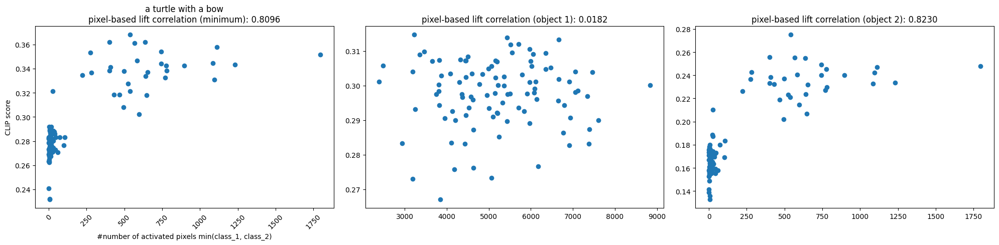

In [6]:
import matplotlib.pyplot as plt

threshold = 3e-4
str_activated_pixels_1 = f'activated_pixels_for_object_1_{threshold:.0e}'
str_activated_pixels_2 = f'activated_pixels_for_object_2_{threshold:.0e}'

str_activated_pixels_1_old = f'activated_pixels_for_object_1_old_{threshold:.0e}'
str_activated_pixels_2_old = f'activated_pixels_for_object_2_old_{threshold:.0e}'

for prompt in df['prompt'].unique()[:5]:
    print(f"prompt: {prompt}")
    # only plot the first prompt
    sub_df = df[df['prompt'] == prompt]

    # print the ratio of samples with activated pixels larger than 200 for both objects
    print(f"ratio of samples with activated pixels larger than 200 for {prompt}: {(sub_df[[str_activated_pixels_1, str_activated_pixels_2]].min(axis=1) > 200).mean():.4f}")
    # print the clip score for all samples
    print(f"clip score for all samples: {sub_df['clip_score'].mean():.4f}")
    print(f"clip score for samples with activated pixels larger than 200: {sub_df[sub_df[[str_activated_pixels_1, str_activated_pixels_2]].min(axis=1) > 200]['clip_score'].mean():.4f}")

    # # scatter plot the maximum lift and the clip score
    # plt.clf()
    # plt.close("all")
    # _, ax = plt.subplots(1, 3, figsize=(20, 5))
    # ax[0].scatter(sub_df[['maximum_lift_object_1', 'maximum_lift_object_2']].min(axis=1), sub_df['clip_score'])
    # ax[0].set_title(f"score-based lift correlation: {sub_df[['maximum_lift_object_1', 'maximum_lift_object_2']].min(axis=1).corr(sub_df['clip_score']):.4f}")
    # ax[1].scatter(sub_df['maximum_lift_object_1'], sub_df['first_half_text_score'])
    # ax[1].set_title(f"score-based lift correlation: {sub_df['maximum_lift_object_1'].corr(sub_df['first_half_text_score']):.4f}")
    # ax[2].scatter(sub_df['maximum_lift_object_2'], sub_df['second_half_text_score'])
    # ax[2].set_title(f"score-based lift correlation: {sub_df['maximum_lift_object_2'].corr(sub_df['second_half_text_score']):.4f}")
    # plt.tight_layout()
    # plt.show()

    # scatter activated pixels for both objects and clip score
    plt.clf()
    plt.close("all")
    _, ax = plt.subplots(1, 3, figsize=(20, 5))
    ax[0].scatter(sub_df[[str_activated_pixels_1, str_activated_pixels_2]].min(axis=1), sub_df['clip_score'])
    ax[0].set_title(f"{prompt}\npixel-based lift correlation (minimum): {sub_df[[str_activated_pixels_1, str_activated_pixels_2]].min(axis=1).corr(sub_df['clip_score']):.4f}")
    # plot multiple vertical lines, 0, 100, 200, 400, 800, 1600, 3200
    # lines = ax[0].vlines([0, 100, 200, 400, 800, 1600, 3200], ymin=sub_df['clip_score'].min(), ymax=sub_df['clip_score'].max(), colors="red", linestyles="dashed")
    # add to ticks
    ax[0].set_ylabel("CLIP score")
    ax[0].set_xlabel("#number of activated pixels min(class_1, class_2)")
    # ax[0].set_xticks([0, 100, 200, 400, 800, 1600, 3200])
    # ax[0].set_xticklabels([0, 100, 200, 400, 800, 1600, 3200])
    # rotate the ticks
    ax[0].tick_params(axis='x', labelrotation=45)

    ax[1].scatter(sub_df[str_activated_pixels_1], sub_df['first_half_text_score'])
    ax[1].set_title(f"pixel-based lift correlation (object 1): {sub_df[str_activated_pixels_1].corr(sub_df['first_half_text_score']):.4f}")
    ax[2].scatter(sub_df[str_activated_pixels_2], sub_df['second_half_text_score'])
    ax[2].set_title(f"pixel-based lift correlation (object 2): {sub_df[str_activated_pixels_2].corr(sub_df['second_half_text_score']):.4f}")
    plt.tight_layout()
    plt.show()


    # # scatter activated pixels of old method for both objects and clip score
    # plt.clf()
    # plt.close("all")
    # _, ax = plt.subplots(1, 3, figsize=(20, 5))
    # ax[0].scatter(sub_df[[str_activated_pixels_1_old, str_activated_pixels_2_old]].min(axis=1), sub_df['clip_score'])
    # ax[0].set_title(f"{prompt}\npixel-based lift correlation (minimum): {sub_df[[str_activated_pixels_1_old, str_activated_pixels_2_old]].min(axis=1).corr(sub_df['clip_score']):.4f}")
    # # plot multiple vertical lines, 0, 100, 200, 400, 800, 1600, 3200
    # # lines = ax[0].vlines([0, 100, 200, 400, 800, 1600, 3200], ymin=sub_df['clip_score'].min(), ymax=sub_df['clip_score'].max(), colors="red", linestyles="dashed")
    # # add to ticks
    # ax[0].set_ylabel("CLIP score")
    # ax[0].set_xlabel("#number of activated pixels min(class_1, class_2)")
    # ax[0].set_xticks([0, 100, 200, 400, 800, 1600, 3200])
    # ax[0].set_xticklabels([0, 100, 200, 400, 800, 1600, 3200])
    # # rotate the ticks
    # ax[0].tick_params(axis='x', labelrotation=45)

    # ax[1].scatter(sub_df[str_activated_pixels_1_old], sub_df['first_half_text_score'])
    # ax[1].set_title(f"pixel-based lift correlation (object 1): {sub_df[str_activated_pixels_1_old].corr(sub_df['first_half_text_score']):.4f}")
    # ax[2].scatter(sub_df[str_activated_pixels_2_old], sub_df['second_half_text_score'])
    # ax[2].set_title(f"pixel-based lift correlation (object 2): {sub_df[str_activated_pixels_2_old].corr(sub_df['second_half_text_score']):.4f}")
    # plt.tight_layout()
    # plt.show()


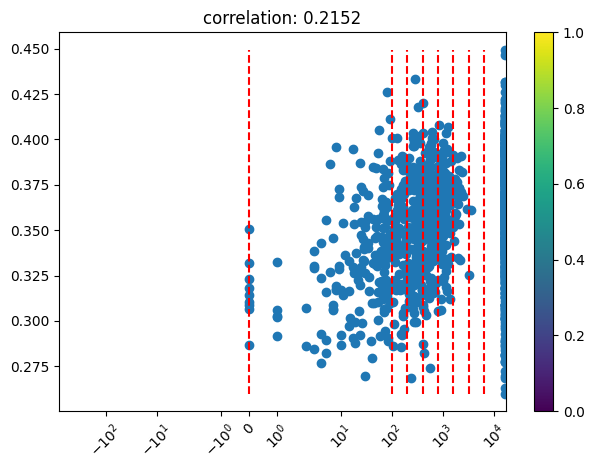

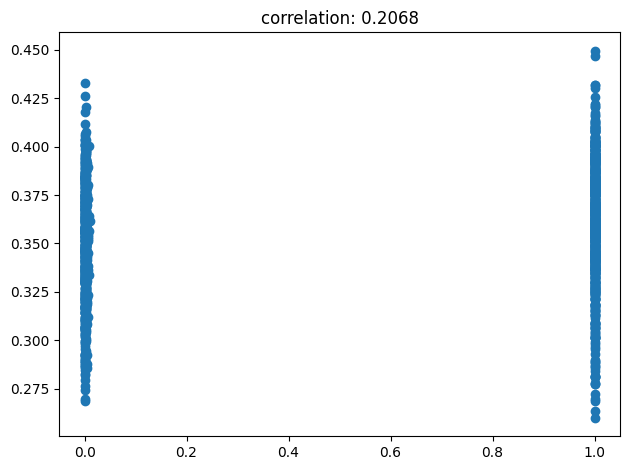

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

# plot the overall correlation
clip_scores = df['clip_score'].values
# calculate the average of clip score for each prompt
average_clip_scores = df.groupby('prompt')['clip_score'].mean()
# offset the clip scores using each sample's belong to which prompt
clip_scores = clip_scores - 0 * df['prompt'].map(average_clip_scores)
threshold_str = threshold_str = f"{2e-4:.0e}"
plt.scatter(df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1), clip_scores)
# title the plot with the correlation
plt.title(f"correlation: {clip_scores.corr(df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1)):.4f}")
# plot the vertical lines
plt.vlines([0, 100, 200, 400, 800, 1600, 3200, 6400], ymin=clip_scores.min(), ymax=clip_scores.max(), colors="red", linestyles="dashed")
# add the ticks
plt.xticks([0, 100, 200, 400, 800, 1600, 3200, 6400])
plt.xticks(rotation=45)
plt.xscale("symlog")
plt.tight_layout()
plt.colorbar()
plt.show()

# plot the correlation to the scores
plt.clf()
plt.close("all")
plt.scatter(df[['maximum_lift_object_1', 'maximum_lift_object_2']].min(axis=1), clip_scores)
plt.title(f"correlation: {df[['maximum_lift_object_1', 'maximum_lift_object_2']].min(axis=1).corr(clip_scores):.4f}")
plt.tight_layout()
plt.show()


In [3]:
# plot a few samples which are rejected
optimal_threshold = 2e-4
optimal_pixel_threshold = 300

threshold_str = f"{optimal_threshold:.0e}"

# plot the samples which are rejected with the prompt
sub_df_rejected = df[df[[f'activated_pixels_for_object_1_{threshold_str}', f'activated_pixels_for_object_2_{threshold_str}']].min(axis=1) < optimal_pixel_threshold]

# 1. First get the value counts
prompt_counts = sub_df_rejected['prompt'].value_counts()

# 2. Create the boolean mask for prompts that aren't fully rejected
not_fully_rejected_and_not_fully_accepted_prompts = prompt_counts[(prompt_counts != 5) & (prompt_counts != 0)].index

# 3. Filter the DataFrame using isin()
sub_df_not_fully = sub_df_rejected[sub_df_rejected['prompt'].isin(not_fully_rejected_and_not_fully_accepted_prompts)]
sub_df_not_fully

,prompt,image_name,clip_score,first_half_text_score,second_half_text_score,maximum_lift_object_1,maximum_lift_object_2,activated_pixels_for_object_1_0e+00,activated_pixels_for_object_2_0e+00,activated_pixels_for_object_1_old_0e+00,...,activated_pixels_for_object_2_old_9e-04,activated_pixels_for_object_1_cached_9e-04,activated_pixels_for_object_2_cached_9e-04,activated_pixels_for_object_1_1e-03,activated_pixels_for_object_2_1e-03,activated_pixels_for_object_1_old_1e-03,activated_pixels_for_object_2_old_1e-03,activated_pixels_for_object_1_cached_1e-03,activated_pixels_for_object_2_cached_1e-03,image_reward_score
14,a bear and a frog,4.png,0.372905,0.262203,0.263416,0.003457,0.002027,14091.0,6163.0,13801.0,...,206.0,5.0,19.0,79.0,17.0,1161.0,185.0,4.0,15.0,1.708175
19,a bear and a gray bench,4.png,0.384367,0.306061,0.297690,0.006711,0.000427,13341.0,5747.0,13242.0,...,0.0,172.0,1.0,479.0,0.0,956.0,0.0,146.0,0.0,1.496678
35,a bear and a mouse,0.png,0.292737,0.270818,0.209201,0.004211,0.000808,15021.0,5930.0,14549.0,...,24.0,26.0,7.0,81.0,0.0,500.0,24.0,21.0,7.0,0.792630
36,a bear and a mouse,3.png,0.299355,0.272683,0.198225,0.005595,0.002769,15180.0,3006.0,15397.0,...,88.0,88.0,39.0,109.0,24.0,740.0,80.0,75.0,34.0,0.319037
37,a bear and a mouse,1.png,0.339345,0.287838,0.254455,0.002285,0.003431,15152.0,7438.0,14401.0,...,118.0,13.0,28.0,44.0,27.0,925.0,110.0,8.0,23.0,1.514521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1371,a yellow glasses and a gray bowl,3.png,0.357038,0.348029,0.228238,0.001263,0.000344,12812.0,12654.0,4806.0,...,0.0,0.0,0.0,7.0,0.0,327.0,0.0,0.0,0.0,1.772015
1372,a yellow glasses and a gray bowl,1.png,0.334268,0.258601,0.295125,0.001289,0.001831,11982.0,15087.0,3278.0,...,76.0,3.0,9.0,2.0,28.0,0.0,45.0,3.0,8.0,-1.379848
1373,a yellow glasses and a gray bowl,2.png,0.325138,0.245895,0.298062,0.000391,0.000471,6629.0,16232.0,813.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.945027
1375,a yellow suitcase and a yellow car,0.png,0.315107,0.278448,0.316642,0.001914,0.002248,15285.0,16079.0,5003.0,...,0.0,12.0,18.0,6.0,8.0,0.0,0.0,9.0,13.0,-1.674173


In [7]:
prompt2improve = dict()

for prompt in sub_df_not_fully['prompt'].unique():
    # print the image names of the rejected samples
    print(sub_df_not_fully[sub_df_not_fully['prompt'] == prompt][['prompt', 'image_name', 'clip_score']])

    # print the accepted samples
    print(df[df['prompt'] == prompt][['prompt', 'image_name', 'clip_score']])

    num_rejected = len(sub_df_not_fully[sub_df_not_fully['prompt'] == prompt])
    num_all = len(df[df['prompt'] == prompt])
    clip_score_accepted = (df[df['prompt'] == prompt]['clip_score'].sum() - sub_df_not_fully[sub_df_not_fully['prompt'] == prompt]['clip_score'].sum()) / (num_all - num_rejected)
    clip_score_all = df[df['prompt'] == prompt]['clip_score'].mean()
    improvement = clip_score_accepted / clip_score_all
    print(f"improvement: {improvement:.4f}")

    prompt2improve[prompt] = improvement

# sort the prompts by improvement
sorted_prompts = sorted(prompt2improve.items(), key=lambda x: x[1], reverse=True)
sorted_prompts = [p for p in sorted_prompts if p[1] > 1]

               prompt image_name  clip_score
14  a bear and a frog      4.png    0.372905
               prompt image_name  clip_score
10  a bear and a frog      0.png    0.371863
11  a bear and a frog      3.png    0.375882
12  a bear and a frog      1.png    0.393686
13  a bear and a frog      2.png    0.372021
14  a bear and a frog      4.png    0.372905
improvement: 1.0029
                     prompt image_name  clip_score
19  a bear and a gray bench      4.png    0.384367
                     prompt image_name  clip_score
15  a bear and a gray bench      0.png    0.353138
16  a bear and a gray bench      3.png    0.378411
17  a bear and a gray bench      1.png    0.361156
18  a bear and a gray bench      2.png    0.394140
19  a bear and a gray bench      4.png    0.384367
improvement: 0.9932
                prompt image_name  clip_score
35  a bear and a mouse      0.png    0.292737
36  a bear and a mouse      3.png    0.299355
37  a bear and a mouse      1.png    0.339345
39  a be

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
import ipywidgets
from PIL import Image
for prompt, _ in sorted_prompts[:20]:
    print("***************************************")
    print(f"prompt: {prompt}")

    all_image_names = [f'{i}.png' for i in range(5)]
    # show the image_name of rejected samples
    sub_df_not_fully[sub_df_not_fully['prompt'] == prompt]['image_name']
    # get the image name with the lowest clip score
    worst_row = sub_df_not_fully[sub_df_not_fully['prompt'] == prompt].loc[
        sub_df_not_fully[sub_df_not_fully['prompt'] == prompt]['clip_score'].idxmin()
    ]
    image_name = worst_row['image_name']
    # get the image
    print(f"image_name: {image_name}")
    image = Image.open(f"outputs/standard_sd_xl_lift/{prompt}/{image_name}")
    plt.clf()
    plt.close("all")
    plt.imshow(image)
    plt.show()
    image = Image.open(f"outputs/standard_sd_xl_lift/{prompt}/heatmaps/heatmap_{image_name}")
    plt.clf()
    plt.close("all")
    plt.imshow(image)
    plt.show()
    for image_name in sub_df_not_fully[sub_df_not_fully['prompt'] == prompt]['image_name']:
        all_image_names.remove(image_name)

    # get the image name with the highest clip score in all_image_names
    sub_df_all = df[df['prompt'] == prompt]
    # filter out the rows with image_name in all_image_names
    sub_df_all = sub_df_all[sub_df_all['image_name'].isin(all_image_names)]
    # get the image name with the highest clip score
    best_row = sub_df_all.loc[sub_df_all['clip_score'].idxmax()]
    image_name = best_row['image_name']
    print(f"image_name: {image_name}")
    plt.clf()
    plt.close("all")
    image = Image.open(f"outputs/standard_sd_xl_lift/{prompt}/{image_name}")
    plt.imshow(image)
    plt.show()
    image = Image.open(f"outputs/standard_sd_xl_lift/{prompt}/heatmaps/heatmap_{image_name}")
    plt.imshow(image)
    plt.show()


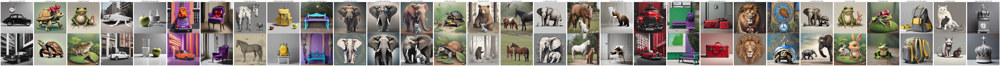

In [9]:
from matplotlib import rc
import matplotlib.pyplot as plt
from PIL import Image

# Create a 2x20 subplot layout
plt.clf()
plt.close("all")

# designated_prompts = [
#     "a black car and a white clock",
#     "a turtle with a bow",
#     "a orange backpack and a purple car",
#     "a elephant with a glasses",
#     "a bird and a horse",
#     "a black crown and a red car",
# ]

designated_prompts = [p for p, _ in sorted_prompts[:30]]

def convert_a_to_an_for_object(object):
    if object[0].lower() in "aeiou":
        result = f"an {object}"
    else:
        result = f"a {object}"
    if result.endswith("es"):
        result = " ".join(result.split(" ")[1:])
    return rf"{result}"

def convert_prompt_to_title(prompt):
    if "and" in prompt:
        object_1, object_2 = prompt.split(" and ")
        object_1 = convert_a_to_an_for_object(" ".join(object_1.split(" ")[1:]))
        object_2 = convert_a_to_an_for_object(" ".join(object_2.split(" ")[1:]))
        return rf"{object_1} and {object_2}"
    else:
        assert "with" in prompt
        object_1, object_2 = prompt.split(" with ")
        object_1 = convert_a_to_an_for_object(" ".join(object_1.split(" ")[1:]))
        object_2 = convert_a_to_an_for_object(" ".join(object_2.split(" ")[1:]))
        return rf"{object_1} with {object_2}"

fig, axes = plt.subplots(2, len(designated_prompts), figsize=(5*len(designated_prompts), 10))
for idx, prompt in enumerate(designated_prompts):
    all_image_names = [f'{i}.png' for i in range(5)]

    # Get worst (rejected) image
    worst_row = sub_df_not_fully[sub_df_not_fully['prompt'] == prompt].loc[
        sub_df_not_fully[sub_df_not_fully['prompt'] == prompt]['clip_score'].idxmin()
    ]
    rejected_image_name = worst_row['image_name']

    # Remove rejected image names from candidates for best image
    for image_name in sub_df_not_fully[sub_df_not_fully['prompt'] == prompt]['image_name']:
        all_image_names.remove(image_name)

    # Get best (accepted) image
    sub_df_all = df[df['prompt'] == prompt]
    sub_df_all = sub_df_all[sub_df_all['image_name'].isin(all_image_names)]
    best_row = sub_df_all.loc[sub_df_all['clip_score'].idxmax()]
    accepted_image_name = best_row['image_name']

    # Plot accepted image in first row
    accepted_img = Image.open(f"outputs/standard_sd_xl_lift/{prompt}/{accepted_image_name}")
    axes[0, idx].imshow(accepted_img)
    axes[0, idx].axis('off')
    axes[0, idx].set_title(convert_prompt_to_title(prompt))#, fontsize=20)#, wrap=True)

    # Plot rejected image in second row
    rejected_img = Image.open(f"outputs/standard_sd_xl_lift/{prompt}/{rejected_image_name}")
    axes[1, idx].imshow(rejected_img)
    axes[1, idx].axis('off')

plt.tight_layout()
plt.savefig("accepted_vs_rejected.png")#, backend='pgf')

In [10]:
[p[0] for p in sorted_prompts]

['a black car and a white clock',
 'a turtle with a bow',
 'a frog and a mouse',
 'a white bow and a white car',
 'a white glasses and a gray apple',
 'a orange backpack and a purple car',
 'a purple chair and a red bow',
 'a horse and a mouse',
 'a yellow backpack and a gray apple',
 'a purple crown and a blue bench',
 'a elephant with a bow',
 'a elephant with a glasses',
 'a cat and a elephant',
 'a turtle and a mouse',
 'a bear and a mouse',
 'a bird and a horse',
 'a elephant and a rabbit',
 'a cat and a horse',
 'a bear and a white chair',
 'a black crown and a red car',
 'a green backpack and a purple bench',
 'a red glasses and a red suitcase',
 'a lion with a bow',
 'a turtle and a blue clock',
 'a elephant and a turtle',
 'a frog and a rabbit',
 'a frog with a bow',
 'a gray backpack and a yellow glasses',
 'a cat and a mouse',
 'a gray crown and a white clock',
 'a red backpack and a yellow bowl',
 'a bird with a glasses',
 'a rabbit and a blue bowl',
 'a cat and a yellow ca